# Domain Decomposition Method for coupling the NSWE and the Serre equations

* Coupling between the NSWE and the Serre equations
* Resolution of the Serre equations with a splitting method (NSWE + (linear) dispersive)

* Schema for coupling :
    * First step : DDM between NSWE + NSWE imposing the characteristic IBCs in the ghost cells of each subdomain (by simply imposing the respective values of the other subdomain)
    * Second step : resolution of the dispersive part of the Serre equation in the respective subdomain (for updating u); in the other subdomain the solution remains constant. Dirichlet IBC to impose continuity in the two points nearer to the interface.
    
* With the IBCs for the NSWE as described above, both domains have the exactly the same stencil as in the monodomain to compute the solution in every point, including the interface points. Therefore, the convergence to the monodomain solution is exact and immediate.

In [1]:
%%writefile DDM_nswe_serre.py
# -*- coding: utf-8 -*-

import sys
sys.path.append('../Serre')
sys.path.append('../')

import numpy as np
import matplotlib.pyplot as plt
import generalFunctions as gF
import muscl2
import nswe_wbmuscl4 as wb4
import serre
import serreTBC
import cnoidal

reload(serreTBC)

Overwriting DDM_nswe_serre.py


In [2]:
%%writefile DDM_nswe_serre.py -a

def openDomainThreeGC(h,hu,BC,dx,t):
    """
    *Function to be passed as "bcfunction" argument for DDM_NSWE
    *Impose classical open boundary conditions in a domain with three ghost cells in each side (necessary for O4).
    *The domain is supposed to be [-L-3*dx, L+3*dx]
    
    *Inputs
        * h, hu : variables to impose the BCs (can be any variable)
        * BC, dx, t : unused in this function
        
    * Outputs :
        * hb,hub : h,hu with BCs
    """
    
    hb = 1.*h
    hub = 1.*hu
    
    hb[0] = h[3]
    hub[0] = hu[3]
    hb[1] = h[3]
    hub[1] = hu[3]
    hb[2] = h[3]
    hub[2] = hu[3]
    
    hb[-1] = h[-4]
    hub[-1] = hu[-4]    
    hb[-2] = h[-4]
    hub[-2] = hu[-4]
    hb[-3] = h[-4]
    hub[-3] = hu[-4]
    
    return hb,hub

Appending to DDM_nswe_serre.py


In [3]:
%%writefile DDM_nswe_serre.py -a

def DDM_BCs(h,hu,BC,dx,t):
    """
    *Function to be passed as "bcfunction" argument for DDM_NSWE
    *Impose user-defined Dirichlet boundary conditions for NSWE solver
    
    *Inputs
        * h, hu : variables to impose the BCs (can be any variable)
        * BC : array with lines in the form [pos,valh, valhu] :
            * pos : position for imposing the boundary condition (0,1,2,...,-3,-2,-1)
            * valh,valhu : values imposed to each variable
        * dx, t : unused in this function
        
    * Outputs :
        * hb,hub : h,hu with BCs
    """
    
    ### BC = [[pos,val h, val hu],]
    hb = 1.*h
    hub = 1.*hu

    for i in range(BC.shape[0]):
        [pos,valh,valhu] = BC[i,:]
        hb[pos] = valh
        hub[pos] = valhu
    
    return hb,hub

Appending to DDM_nswe_serre.py


In [4]:
%%writefile DDM_nswe_serre.py -a

def fluxes(h,hu,n):
    """
    *Function to be passed as "fvsolver" argument for DDM_NSWE
    *Impose periodicty to ghost cells and compute the fluxes
    *The domain is supposed to be [-L-3*dx, L+3*dx]
    
    *Inputs
        * h, hu
        * n : unused in this function
        
    * Outputs :
        * fp : fluxes on the cells' interfaces
    """
    
    h0 = np.copy(h)
    u0 = np.copy(hu)
    d0 = np.zeros(n)
    u0 = np.where(h0>1e-10,u0/h0,h0)#hu/h
    
    fp, fm, sc = wb4.fluxes_sources(d0,h0,u0)
    return fp

Appending to DDM_nswe_serre.py


In [5]:
%%writefile DDM_nswe_serre.py -a

def DDM(x1,h1,u1,x2,h2,u2,t0,tmax,bcfunction,dx,nx,
             dt = 0.05, fvsolver=muscl2.fluxes2,fvTimesolver=serre.Euler,
             ghostcells = 3,externalBC="open",coupleSerre=False,serreDomain=1,dispersiveBC = None,
             ov = 0,href=None,uref=None,xref=None, debug = False, dirichletIBC = False,eta=0.):
    
    """
    *Applies a DDM to solve the NSWE in two subdomains;
    *Possibly solve the dispersive part of the Serre equation in one of the subdomains
    
    * Inputs:
        - x1,x2,xref : subdomains/monodomain
        - h1,h2,u1,u2,href,uref : solutions in the subdomains/in the monodomain.
        - t0,tmax,dt
        - dx
        - nx: number of points in monodomain
        - bcfunction : function to impose BCs in the NSWE solver (ex: function DDM_BCs defined above)
        - fvsolver : function to compute the fluxes in the NSWE part (ex: fucntion fluxes defined above)
        - fvTimesolver : function to integrate the NSWE in time
        - ghost cells : number of ghost cells in each side
        - externalBC: "open"/"periodic" (only the "open" case is correctly defined)
        - coupleSerre : True/False : compute the dispersive part
        - serreDomain (1/2): subdomain with the dispersive equation
        - nitermax
        - dispersiveBC : BCs for the dispersive part, in the form [position,type,value,coefficients].
                         see doc in serreTBC.ipynb
        - dirichletIBC : if True, impose dirichlet in the two cells closest to the interface and
                         ignores the argument dispersiveIBC
        - ov : size of overlap (Number of overlapped cells = 1 + 2*ov, ov>=0); ov < 0  means no overlapping
        - debug : impose referential solution in ghost cells
        - eta : slope of the bottom
    """
    
    nitermax = 1 ## it's not a DDM
    
    configDDM = 2  ## overlapping
    if ov < 0: ## no overlapping
        configDDM = 1
    
    t = t0
    it = 0
    grav = 9.81
    
    uall1 = u1
    hall1 = h1
    tall1 = np.ones(1)*t0
    uall2 = u2
    hall2 = h2
    tall2 = np.ones(1)*t0
    huref = href*uref
    
    while t < tmax and dt > 1e-9:
        it = it+1
        t = t+dt
        #print("t = ",t)
        
        h1prev = np.copy(h1)
        u1prev = np.copy(u1)
        h2prev = np.copy(h2)
        u2prev = np.copy(u2)
        hu1prev = h1prev*u1prev
        hu2prev = h2prev*u2prev
        
        niter = 0
        converg = False
        
        while niter < nitermax and converg == False:
            
            niter = niter+1
            
            h1mm = np.copy(h1)
            u1mm = np.copy(u1)
            h2mm = np.copy(h2)
            u2mm = np.copy(u2)
            
            hu1 = h1*u1
            hu2 = h2*u2

            Nddm = nx/2

            if externalBC == "periodic":
                bcparam1 = np.array([[0,h2[-6],hu2[-6]], #external
                                     [1,h2[-5],hu2[-5]], #external
                                     [2,h2[-4],hu2[-4]], #external
                                     [-3,h2[3],hu2[3]],  #interface
                                     [-2,h2[4],hu2[4]],  #interface
                                     [-1,h2[5],hu2[5]]]) #interface
                bcparam2 = np.array([[0,h1[-6],hu1[-6]], #interface
                                     [1,h1[-5],hu1[-5]], #interface
                                     [2,h1[-4],hu1[-4]], #interface
                                     [-3,h1[3],hu1[3]],  #external
                                     [-2,h1[4],hu1[4]],  #external 
                                     [-1,h1[5],hu1[5]]]) #external
            elif externalBC == "open":
                if configDDM == 1: ## without overlapping
                    bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                         [1,h1prev[3],hu1prev[3]],
                                         [2,h1prev[3],hu1prev[3]],
                                         [-3,h2[3],hu2[3]],
                                         [-2,h2[4],hu2[4]],
                                         [-1,h2[5],hu2[5]]])
                    bcparam2 = np.array([[0,h1[-6],hu1[-6]],
                                         [1,h1[-5],hu1[-5]],
                                         [2,h1[-4],hu1[-4]],
                                         [-3,h2prev[-4],hu2prev[-4]],
                                         [-2,h2prev[-4],hu2prev[-4]],
                                         [-1,h2prev[-4],hu2prev[-4]]])
                elif configDDM == 2:
                    if not debug : ## with overlapping
                        bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                             [1,h1prev[3],hu1prev[3]],
                                             [2,h1prev[3],hu1prev[3]],
                                             [-3,h2[4+2*ov],hu2[4+2*ov]],
                                             [-2,h2[5+2*ov],hu2[5+2*ov]],
                                             [-1,h2[6+2*ov],hu2[6+2*ov]]])
                        bcparam2 = np.array([[0,h1[-7-2*ov],hu1[-7-2*ov]],
                                             [1,h1[-6-2*ov],hu1[-6-2*ov]],
                                             [2,h1[-5-2*ov],hu1[-5-2*ov]],
                                             [-3,h2prev[-4],hu2prev[-4]],
                                             [-2,h2prev[-4],hu2prev[-4]],
                                             [-1,h2prev[-4],hu2prev[-4]]])

                    else:
                        Nddm = nx/2
                        print(Nddm)
                        bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                             [1,h1prev[3],hu1prev[3]],
                                             [2,h1prev[3],hu1prev[3]],
                                             [-3,href[Nddm+1,it],huref[Nddm+1,it]],
                                             [-2,href[Nddm+2,it],huref[Nddm+2,it]],
                                             [-1,href[Nddm+3,it],huref[Nddm+3,it]]])
                        bcparam2 = np.array([[0,href[Nddm-3,it],huref[Nddm-3,it]],
                                             [1,href[Nddm-2,it],huref[Nddm-2,it]],
                                             [2,href[Nddm-1,it],huref[Nddm-1,it]],
                                             [-3,h2prev[-4],hu2prev[-4]],
                                             [-2,h2prev[-4],hu2prev[-4]],
                                             [-1,h2prev[-4],hu2prev[-4]]])

            h1,hu1 = bcfunction(h1,hu1,bcparam1,dx,t)
            h2,hu2 = bcfunction(h2,hu2,bcparam2,dx,t)

            if debug :
                print("Stencils around the interface point (href,h1,h2):")
                print("g-3","g-2","g-1","Int","g1","g2","g3")
                print(href[Nddm-3:Nddm+4,it])
                print(h1[-7:])
                print(h2[:7])

            h1,hu1 = fvTimesolver(x1,h1prev,hu1prev,fvsolver,bcfunction,bcparam1,dx,dt,x1.size,t,ghostcells)
            h2,hu2 = fvTimesolver(x2,h2prev,hu2prev,fvsolver,bcfunction,bcparam2,dx,dt,x2.size,t,ghostcells)   

            if debug :
                print("")
                print("**********")
                print("Debugging")
                print("**********")
                print("")
                print("Verification of the interface position [M,Om1,Om2]:")
                print(xref[Nddm],x1[-4],x2[3])
                print("")
                print("Verification of the solution in ghost cells (h1,href):")
                print("Int","g1","g2","g3")
                print(h1[-4:])
                print(href[Nddm+ov:Nddm+4+ov,it])
                print("")
                print("Verification of the solution in the first cells (h1,href):")
                print("-3","-2","-1","Int")
                print(h1[-7:-3])
                print(href[Nddm-3+ov:Nddm+1+ov,it])
                print("")
                print("Verification of the solution in ghost cells (h2,href):")
                print("g-3","g-2","g-1","Int")
                print(h2[:4])
                print(href[Nddm-3-ov:Nddm+1-ov,it])
                print("")
                print("Verification of the solution in the first cells (h2,href):")
                print("Int","1","2","3")
                print(h2[3:7])
                print(href[Nddm-ov:Nddm+4-ov,it])
                print("")
                print("**///***///***///***")
                print("")
                print("")
            #u1 = np.where(h1[:]>1e-5, hu1[:]/h1[:], 0.)
            #u2 = np.where(h2[:]>1e-5, hu2[:]/h2[:], 0.)   
            

            ## correct ghost cells on the interface (unnecessary?)
            if externalBC == "open":   
                if configDDM == 1:
                    bcparam1 = np.array([[-3,h2[3],hu2[3]],
                                         [-2,h2[4],hu2[4]],
                                         [-1,h2[5],hu2[5]]])
                    bcparam2 = np.array([[0,h1[-6],hu1[-6]],
                                         [1,h1[-5],hu1[-5]],
                                         [2,h1[-4],hu1[-4]]])
                elif configDDM == 2:
                    if not debug :
                        bcparam1 = np.array([[-3,h2[4+2*ov],hu2[4+2*ov]],
                                             [-2,h2[5+2*ov],hu2[5+2*ov]],
                                             [-1,h2[6+2*ov],hu2[6+2*ov]]])
                        bcparam2 = np.array([[0,h1[-7-2*ov],hu1[-7-2*ov]],
                                             [1,h1[-6-2*ov],hu1[-6-2*ov]],
                                             [2,h1[-5-2*ov],hu1[-5-2*ov]]])
                    else :
                        bcparam1 = np.array([[-3,href[Nddm+1,it],huref[Nddm+1,it]],
                                             [-2,href[Nddm+2,it],huref[Nddm+2,it]],
                                             [-1,href[Nddm+3,it],huref[Nddm+3,it]]])
                        bcparam2 = np.array([[0,href[Nddm-3,it],huref[Nddm-3,it]],
                                             [1,href[Nddm-2,it],huref[Nddm-3,it]],
                                             [2,href[Nddm-1,it],huref[Nddm-1,it]]])
            h1,hu1 = bcfunction(h1,hu1,bcparam1,dx,t)
            h2,hu2 = bcfunction(h2,hu2,bcparam2,dx,t)
            u1 = np.where(h1[:]>1e-5, hu1[:]/h1[:], 0.)
            u2 = np.where(h2[:]>1e-5, hu2[:]/h2[:], 0.)   
            
            ## verify convergence
            eps = 1e-9
            if np.linalg.norm(h1-h1mm) < eps and np.linalg.norm(h2-h2mm) < eps and \
               np.linalg.norm(u1-u1mm) < eps and np.linalg.norm(u2-u2mm) < eps :
                    converg = True

            ## Error in the subdomains
            nxx = uref.shape[0]
            err1 = np.linalg.norm(u1[3:-3]-uref[3:u1.size-3,it])
            err2 = np.linalg.norm(u2[3:-3]-uref[nxx-u2.size+3:-3,it])
            
            if not coupleSerre :
                print("")
                print("t = %f"%t)
                print("Error wr to monodomain solution (Om1,Om2): ",err1,err2)
                print("")
            
        #solve Dispersion for one of the domains
        FDorder = 4  ## order of FD scheme
        
        if coupleSerre:
            if serreDomain == 1:  ## serre in the left
                    ## define boundary conditions
                
                if dirichletIBC :  ## Dirichlet condition
                    dispersiveBC = np.array([[0,"Robin",u1[0],1.,0.], ##dispersiveBC = np.array([[0,"Robin",0.,1.,0.]
                                     [-2,"Robin",u1[-5],1.,0.], ## external boundaries
                                     [-1,"Robin",u1[-4],1.,0.]]) ## interface : Dirichlet 
                u1aux = serreTBC.EFDSolverFM4(h1[3:-3],u1[3:-3],dx,dt,FDorder,dispersiveBC)
                u1 = np.hstack((u1[:3],u1aux,u1[-3:]))               
                ## copy to overlapped area
                u2[3:4+2*ov] = u1[-4-2*ov:-3]
            elif serreDomain == 2:
                if dirichletIBC :
                    dispersiveBC = np.array([[0,"Robin",u2[3],1.,0.],
                                     [1,"Robin",u2[4],1.,0.],
                                     [-1,"Robin",0.,1.,0.]])
                u2aux = serreTBC.EFDSolverFM4(h2[3:-3],u2[3:-3],dx,dt,FDorder,dispersiveBC)
                u2 = np.hstack((u2[:3],u2aux,u2[-3:]))
                ## copy to overlapped area
                u1[-4-2*ov:-3] = u2[3:4+2*ov]

        hall1 = np.column_stack((hall1,h1))
        uall1 = np.column_stack((uall1,u1))
        tall1 = np.hstack((tall1,t*np.ones(1)))

        hall2 = np.column_stack((hall2,h2))
        uall2 = np.column_stack((uall2,u2))
        tall2 = np.hstack((tall2,t*np.ones(1)))
    return hall1,uall1,tall1,hall2,uall2,tall2

Appending to DDM_nswe_serre.py


## Remarks on the order of solvers and spatial discretizations

In all the following tests, the NSWE will be solved using a 4th order scheme. This requires 3 ghost cells in each boundary of the domain. Therefore, the domain [a,b] (which can be the monodomain or the subdomains in the DDM) will be discretized in the form [a-3*dx,b+3*dx], with N+6 discrete points. The initial function is defined only in [a,b].

## Remarks on the overlapping of subdomains

* $ov < 0$ : no overlapping
* $ov \geq 0$ : overlapping
* Number of overlapped cells : $1 + 2ov $

* Correspondence with ghost cells : 
 * $\Omega_1$ to $\Omega_2$ : $-7 + i - 2ov \longrightarrow i, \ \ i = 0,1,2$
 * $\Omega_2$ to $\Omega_1$ : $ 7 + i + 2ov \longrightarrow i, \ \ i = -3,-2,-1$

<img src="IMGnoOVLP.jpg">

<img src="IMGOVLP.jpg">

## NSWE in monodomain

In [1]:
import sys

sys.path.append('../Serre')
sys.path.append('../nswe')
sys.path.append('../')

import numpy as np
import matplotlib.pyplot as plt
import generalFunctions as gF
import muscl2
import nswe_wbmuscl4 as wb4
import serre
import serreTBC
import cnoidal
import DDM_nswe_serre as ddmNS

reload(ddmNS)
%matplotlib inline

%matplotlib inline

In [2]:
## Parameters used in all the simulations
a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 3.
dt = 0.01

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = lam
xmin = -4.*L
xmax = L

#tmax = 2.
#dt = 0.01
#L = 2.*lam
#xmin = -L
#xmax = L


nx = 100

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

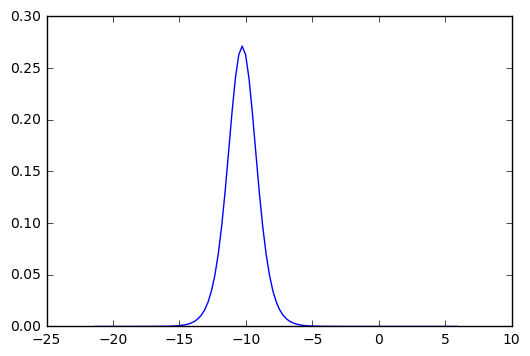

In [3]:
## NSWE in monodomain

## initial solution (in the left part of the domain) .5
h,u = cnoidal.analyticalSolutionSolitary(x[3:-3]-.5*xmin,t,a0,a1) 
## complete with zeros in the righ
#vzeros = np.zeros_like(x[nx/2:-3])
#h = np.concatenate((hprov,vzeros))
#u = np.concatenate((uprov,vzeros))

h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)
#h,u = serre.periodicDomainTwoGC(h,u,None,dx,0)

#print(x[3:nx/2].shape,uprov.shape)
plt.plot(x,u)
##plt.plot(x,h)

In [4]:
print(x.size,h.size,u.size)
hall,uall,tall = serre.NSWE(x,h,u,t0,tmax,ddmNS.openDomainThreeGC,None,dx,x.size,vardt = False, dt = dt,
                              fvsolver=ddmNS.fluxes, ghostcells=3,fvTimesolver=serre.Euler)

umin = np.amin(uall)
umax = np.amax(uall)
hmin = np.amin(hall)
hmax = np.amax(hall)

## store referential solution
xM = np.copy(x)
uallM = np.copy(uall)
hallM = np.copy(hall)
tallM = np.copy(tall)

(107, 107, 107)
CFL = 0.589879


In [5]:
hmax

0.40000000000000002

*** Plotting animation ...



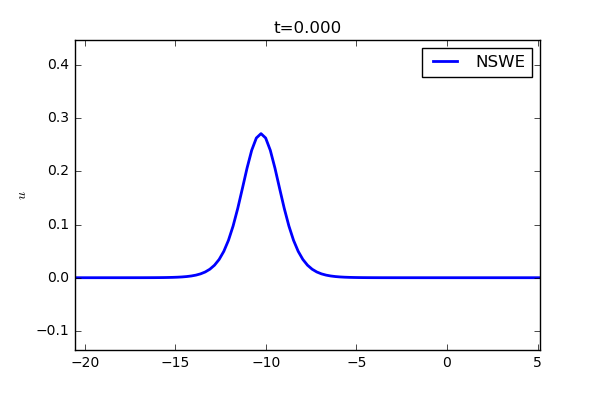
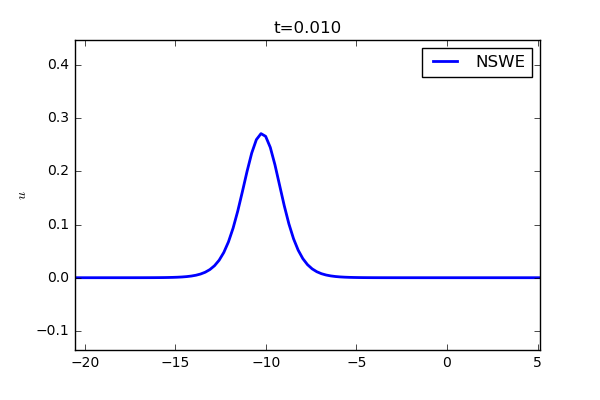
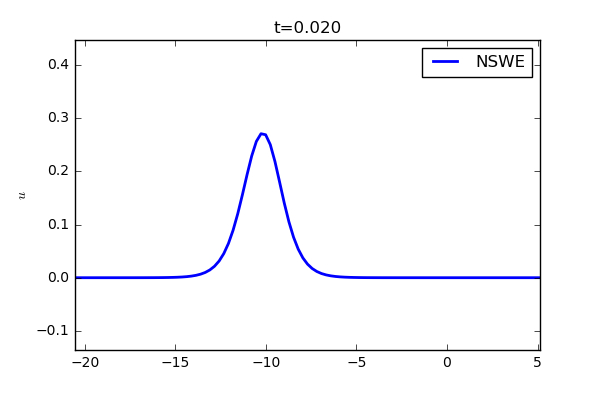
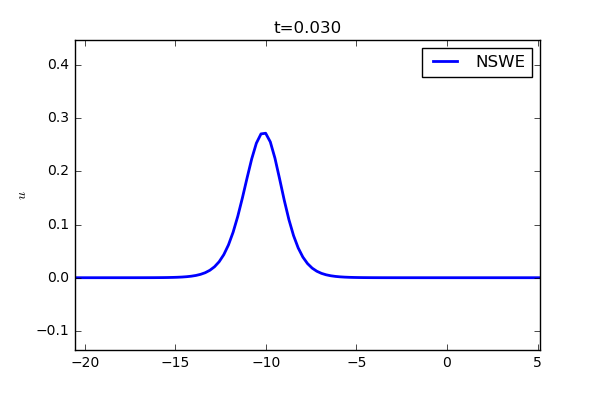
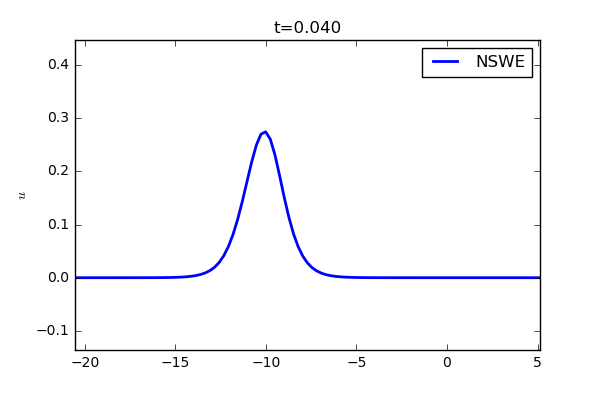
...
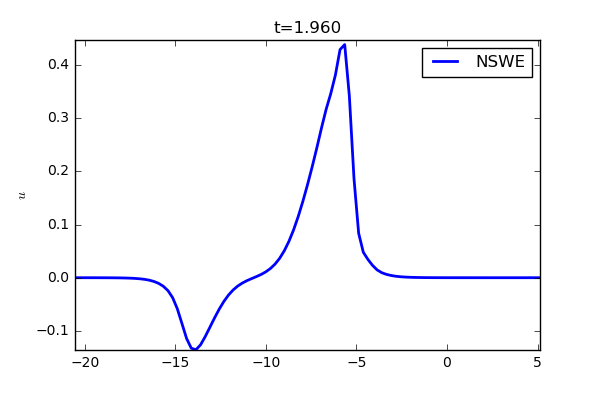
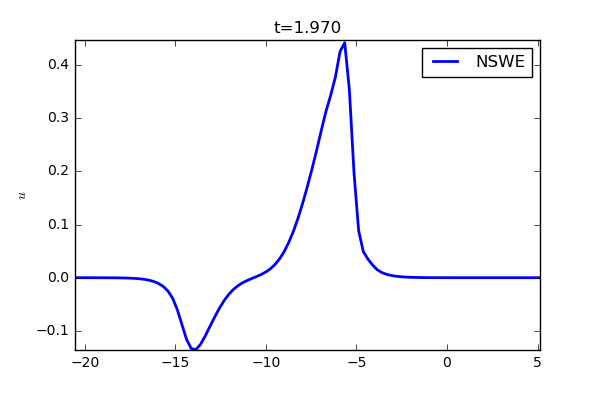
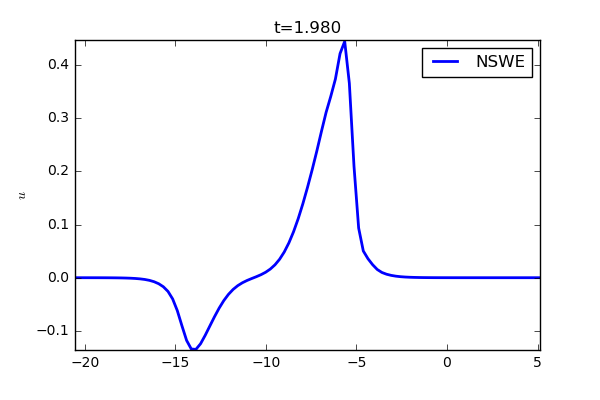
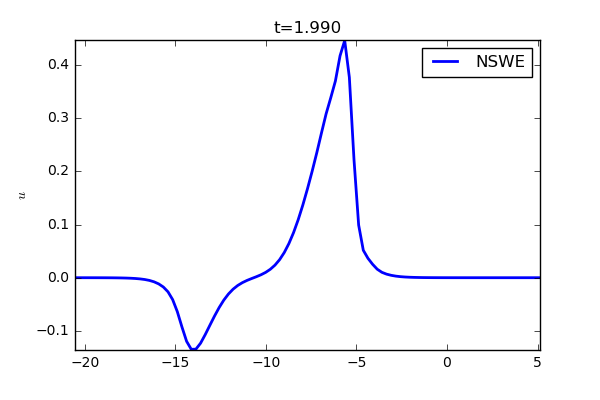
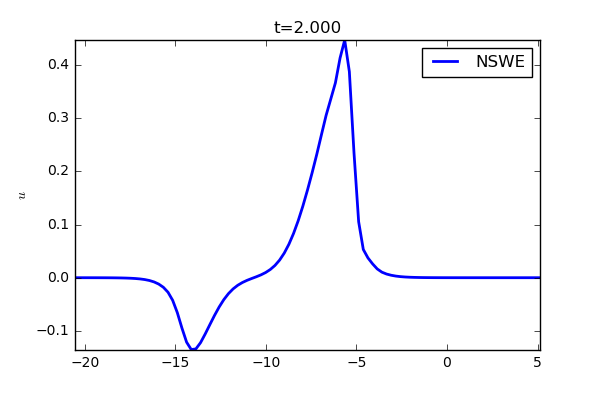

In [6]:
lb = ["NSWE"]
gF.plotAnimationNSolutions(1,xM,np.array([uallM]),tallM,xmin,xmax,umin,umax,lb,ylabel=r'$u$')

In [ ]:
lb = ["NSWE"]
gF.plotAnimationNSolutions(1,xM,np.array([hallM]),tallM,xmin,xmax,0.99*h0,1.01*hmax,lb,ylabel=r'$u$')

*** Plotting animation ...


## DDM with overlapping 

### Only NSWE

In [6]:
Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

print(x[Nddm],Nddm)

#overlapping size
ov = 0 ## ov = 0: 1 cell overlapped (see comments on the above figure)
       ## ov < 0 : no overlapping

if ov<0 : ## no overlapping
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
else :
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]

## TBC for dispersive equation
## in right domain

print(x1[-3]-x2[4+2*ov],x2[0]-x1[-7-2*ov])



hall1,uall1,tall1,hall2,uall2,tall2 = ddmNS.DDM(x1,h1,u1,x2,h2,u2,t0,tmax,ddmNS.DDM_BCs,dx,nx+6,
             dt = dt, fvsolver=ddmNS.fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=False,ov=ov,uref=uallM,
                                              href = hallM,xref=x,debug=False, fvTimesolver=serre.Euler)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

107
[-7.70667201 -7.44978295 -7.19289388]
(-7.7066720126085748, 53)
(0.0, 0.0)

t = 0.010000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.020000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.030000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.040000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.050000

DDM_nswe_serre.py:71: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  hb[pos] = valh
DDM_nswe_serre.py:72: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  hub[pos] = valhu
DDM_nswe_serre.py:308: RuntimeWarning: invalid value encountered in divide
  u1 = np.where(h1[:]>1e-5, hu1[:]/h1[:], 0.)
DDM_nswe_serre.py:309: RuntimeWarning: invalid value encountered in divide
  u2 = np.where(h2[:]>1e-5, hu2[:]/h2[:], 0.)



('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.060000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.070000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.080000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.090000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.100000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.110000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.120000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.130000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.140000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.150000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.160000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.170000
('Error wr to monodomain solution (Om1,Om2): ', 0.0, 0.0)


t = 0.180000
('Error wr to monodomain solution (Om1,Om2): ', 0.

### NSWE + dispersive in the left (imposing continuity in interface)

In [7]:
## DDM

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

ov = 0
if ov < 0:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
else :
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]


c1 = 1.
c2 = 1.


lamb1 = c1
S1 = -c2-lamb1
P1 = 3*c2/(h0*h0*c1)    
    
serreDomain = 1
if serreDomain == 1:
    BCconfig = np.array([[0,"TBC",0.,0.,-1./lamb1,1.],
                             [1,"TBC",0.,-1./(lamb1*lamb1),0,1.],
                             [-1,"TBC",0.,P1,-S1,1.]])
else :
    BCconfig = np.array([[0,"TBC",0.,0.,-1./lamb1,1.],
                             [1,"TBC",0.,-1./(lamb1*lamb1),0,1.],
                             [-1,"TBC",0.,P1,-S1,1.]])
    
hall1DL,uall1DL,tall1DL,hall2DL,uall2DL,tall2DL = ddmNS.DDM(x1,h1,u1,x2,h2,u2,t0,tmax,ddmNS.DDM_BCs,dx,nx,
             dt = dt, fvsolver=ddmNS.fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
                                              ov=ov,fvTimesolver=serre.Euler,uref=uallM,
                                              href = hallM,xref=x,dirichletIBC=True)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1DLP = x1[3:-3]
x2DLP = x2[3:-3]
uall1DLP = uall1DL[3:-3,:]
uall2DLP = uall2DL[3:-3,:]
hall1DLP = hall1DL[3:-3,:]
hall2DLP = hall2DL[3:-3,:]

107
[-7.70667201 -7.44978295 -7.19289388]


*** Plotting animation ...



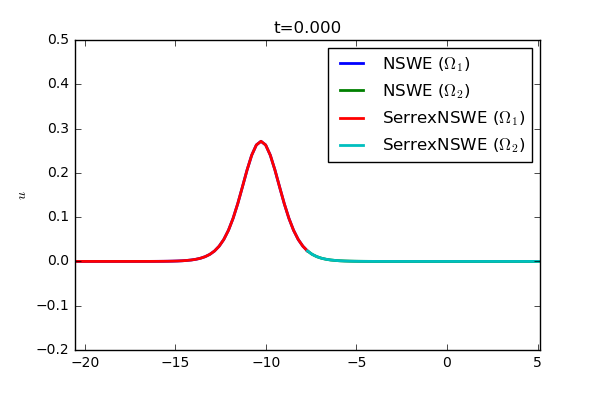
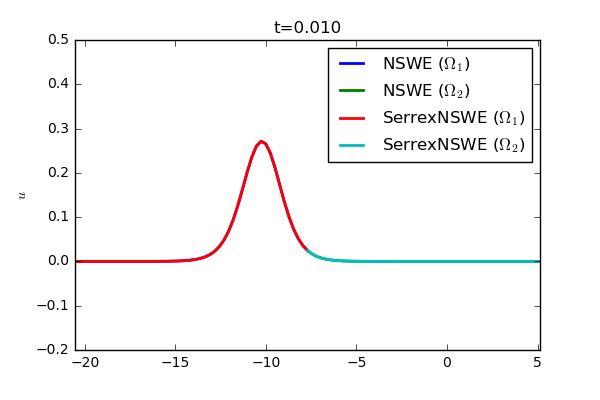
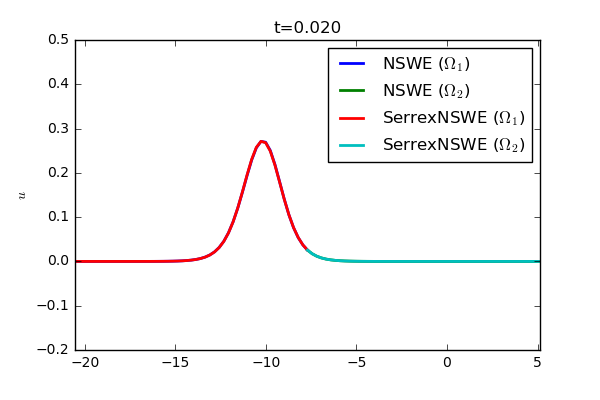
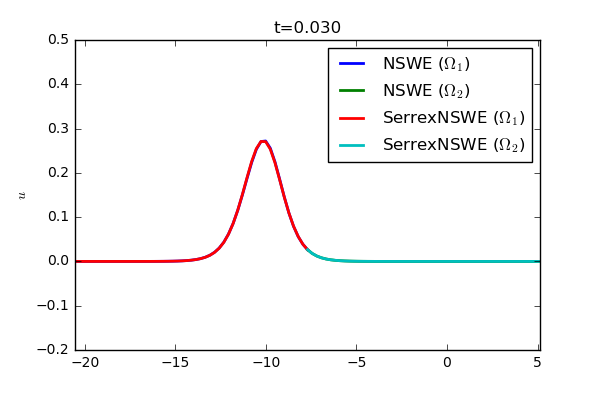
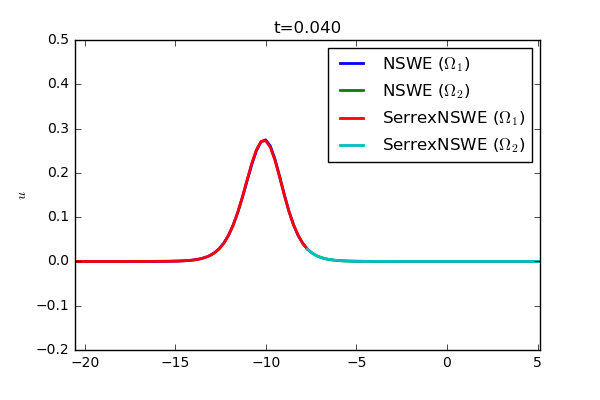
...
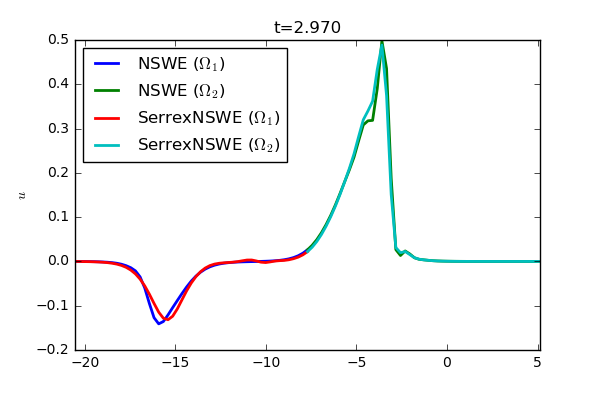
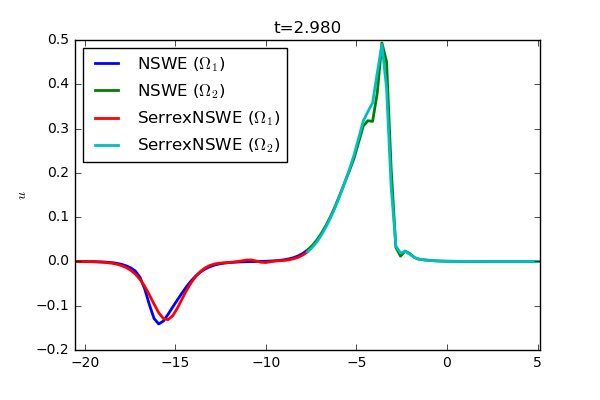
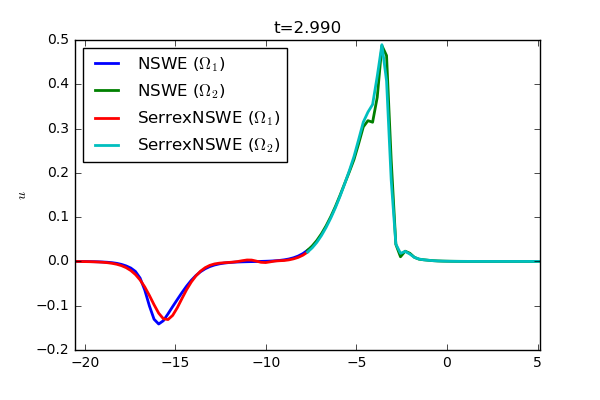
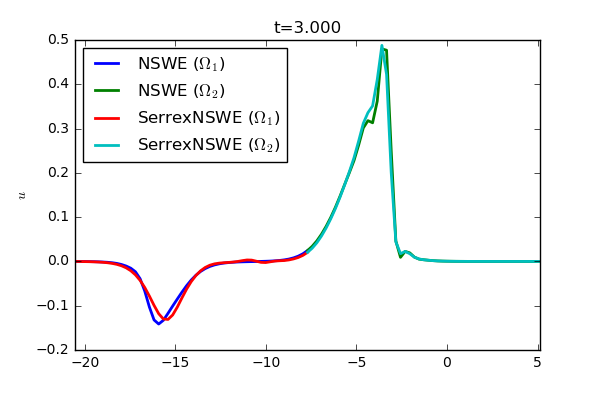
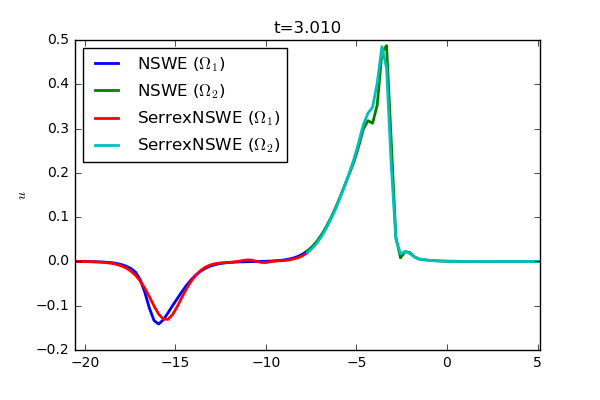

In [8]:
lb = ["NSWE ($\Omega_1$)","NSWE ($\Omega_2$)", "SerrexNSWE ($\Omega_1$)", "SerrexNSWE ($\Omega_2$)"]
#lb = ["SerrexNSWE ($\Omega_1$)", "SerrexNSWE ($\Omega_2$)"]
gF.plotAnimationNSolutionsDiffDomain(4,np.array([x1P,x2P,x1DLP,x2DLP]),
                                     np.array([uall1P,uall2P,uall1DLP,uall2DLP]),
                                     tall1DL,xmin,xmax,-0.2,0.5,lb,ylabel=r'$u$')

In [ ]:
lb = ["NSWE ($\Omega_1$)","NSWE ($\Omega_2$)", "SerrexNSWE ($\Omega_1$)", "SerrexNSWE ($\Omega_2$)"]
gF.plotAnimationNSolutionsDiffDomain(4,np.array([x1P,x2P,x1DLP,x2DLP]),
                                     np.array([hall1P,hall2P,hall1DLP,hall2DLP]),
                                     tall1DL,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

*** Plotting animation ...


### NSWE + dispersive in the right (imposing continuity in interface)

In [9]:
## DDM

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

ov = 0
if ov < 0:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
else:
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]


c1 = 1.
c2 = 1.


lamb1 = c1
S1 = -c2-lamb1
P1 = 3*c2/(h0*h0*c1)    
    
serreDomain = 2
if serreDomain == 1:
    BCconfig = np.array([[0,"TBC",0.,0.,-1./lamb1,1.],
                             [1,"TBC",0.,-1./(lamb1*lamb1),0,1.],
                             [-1,"TBC",0.,P1,-S1,1.]])
#    BCconfig = np.array([[0,"Robin",0.,0.,1.],
#                                 [1,"Robin",0.,1.,0.],
#                                 [-1,"Robin",0.,0.,1.]])
else :
    BCconfig = np.array([[0,"TBC",0.,0.,-1./lamb1,1.],
                             [1,"TBC",0.,-1./(lamb1*lamb1),0,1.],
                             [-1,"TBC",0.,P1,-S1,1.]])
    
    #BCconfig = np.array([[0,"Robin",0.,0.,1.],
    #                             [-2,"Robin",0.,1.,0.],
    #                             [-1,"Robin",0.,0.,1.]])
    
    
hall1DR,uall1DR,tall1DR,hall2DR,uall2DR,tall2DR = ddmNS.DDM(x1,h1,u1,x2,h2,u2,t0,tmax,ddmNS.DDM_BCs,dx,nx,
             dt = dt, fvsolver=ddmNS.fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
                                              ov=ov,fvTimesolver=serre.Euler,uref=uallM,
                                              href = hallM,xref=x,dirichletIBC=True)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1DRP = x1[3:-3]
x2DRP = x2[3:-3]
uall1DRP = uall1DR[3:-3,:]
uall2DRP = uall2DR[3:-3,:]
hall1DRP = hall1DR[3:-3,:]
hall2DRP = hall2DR[3:-3,:]

107
[-7.70667201 -7.44978295 -7.19289388]


*** Plotting animation ...



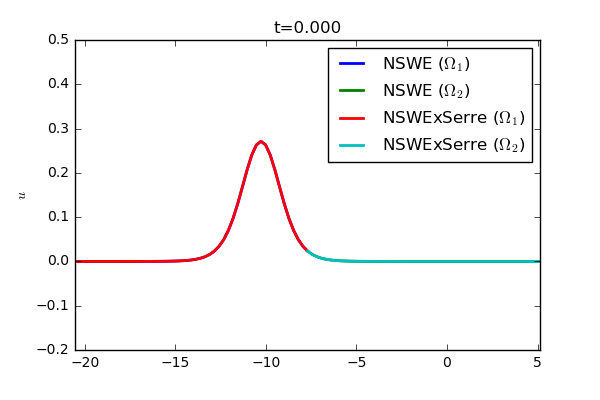
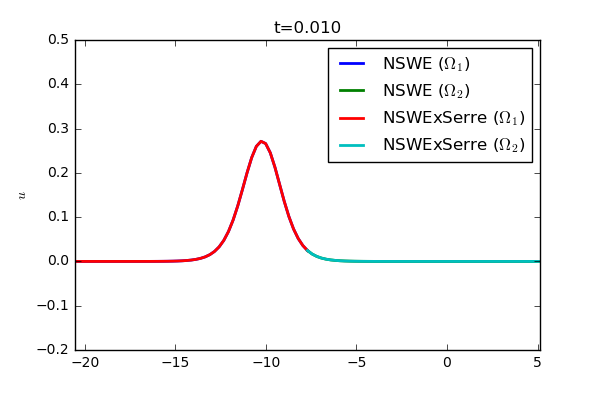
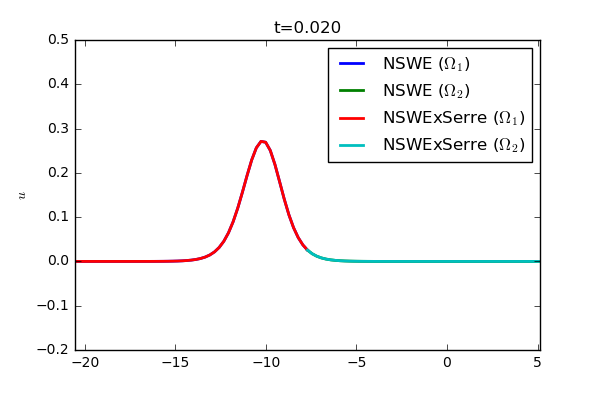
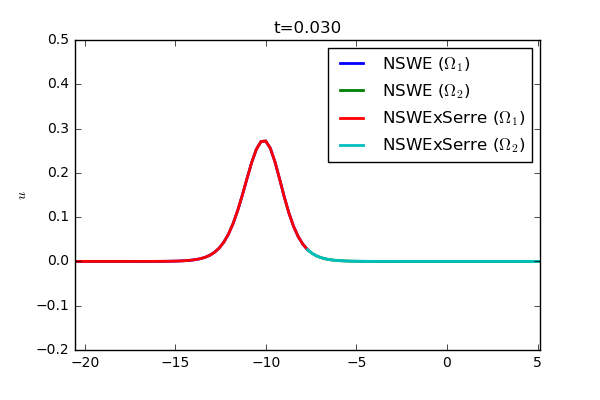
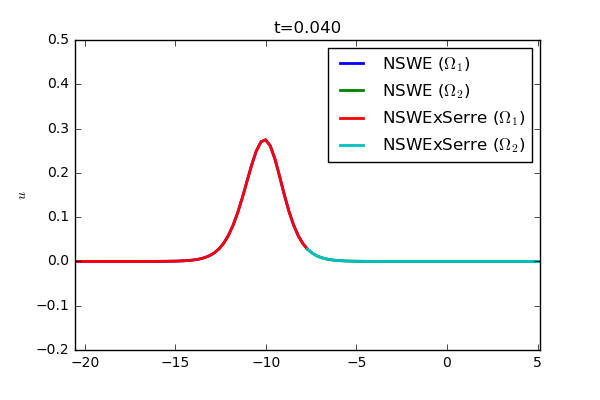
...
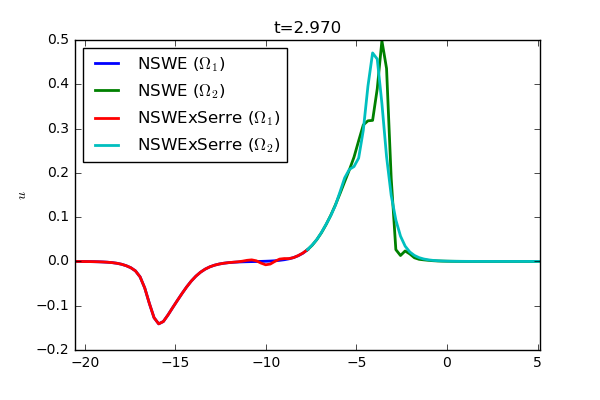
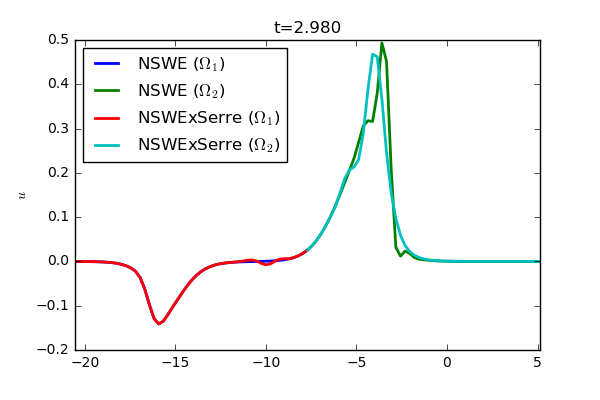
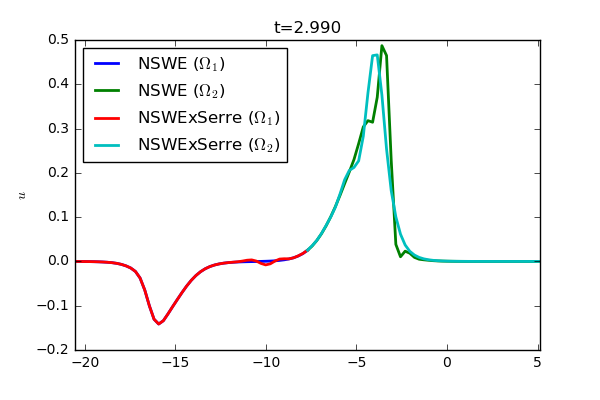
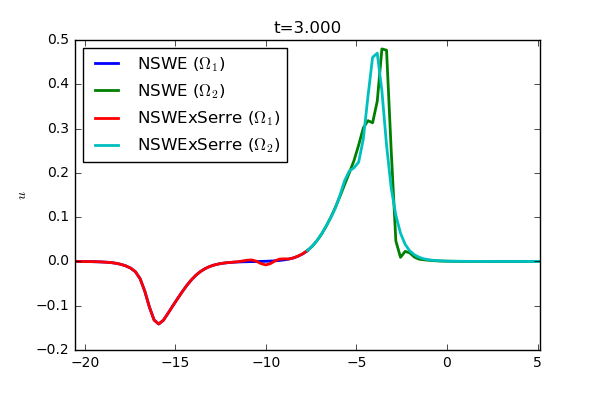
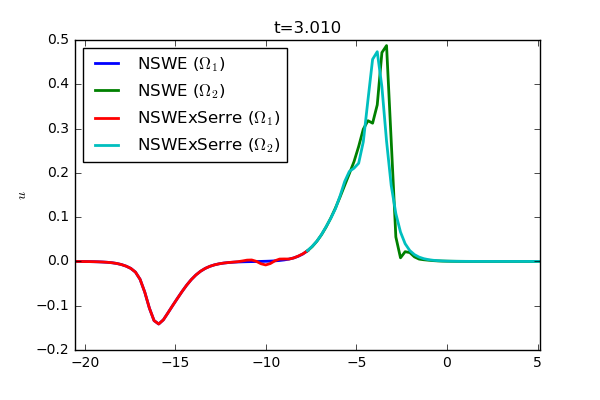

In [10]:
lb = ["NSWE ($\Omega_1$)","NSWE ($\Omega_2$)", "NSWExSerre ($\Omega_1$)", "NSWExSerre ($\Omega_2$)"]
#lb = ["SerrexNSWE ($\Omega_1$)", "SerrexNSWE ($\Omega_2$)"]
gF.plotAnimationNSolutionsDiffDomain(4,np.array([x1P,x2P,x1DRP,x2DRP]),
                                     np.array([uall1P,uall2P,uall1DRP,uall2DRP]),
                                     tall1DR,xmin,xmax,-0.2,0.5,lb,ylabel=r'$u$')

*** Plotting animation ...



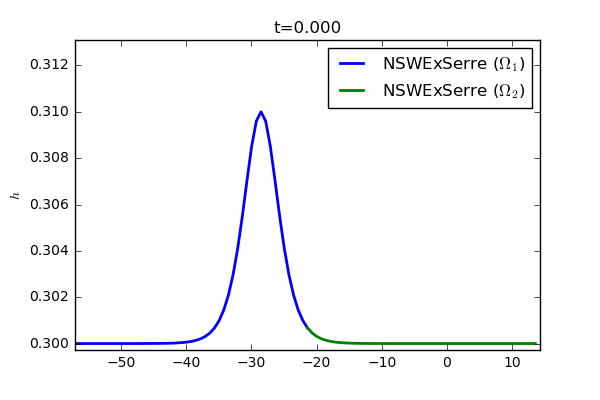
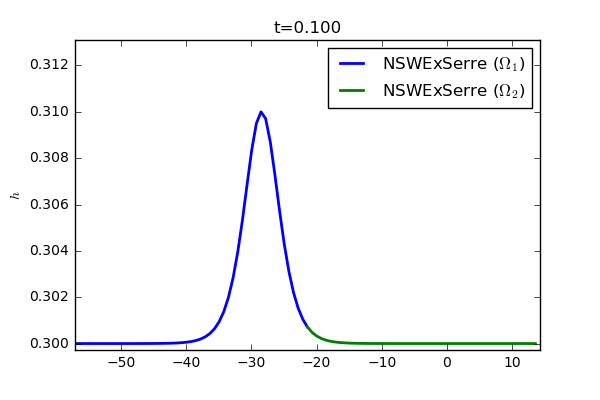
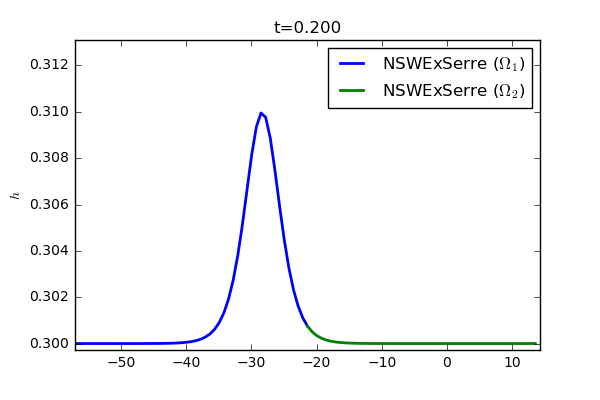
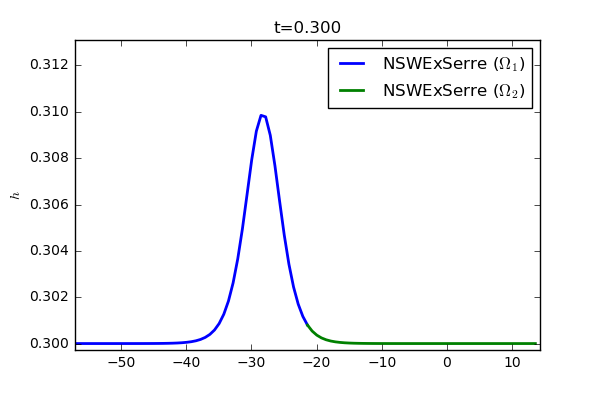
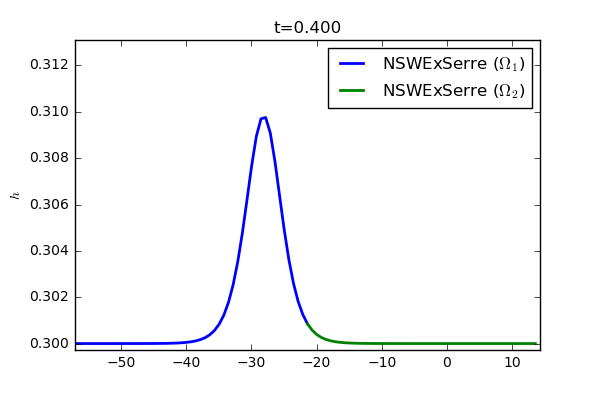
...
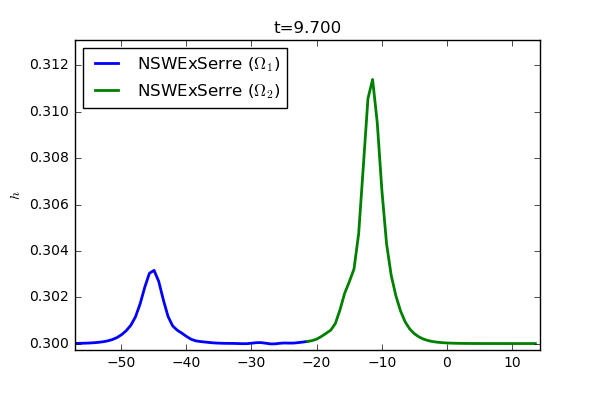
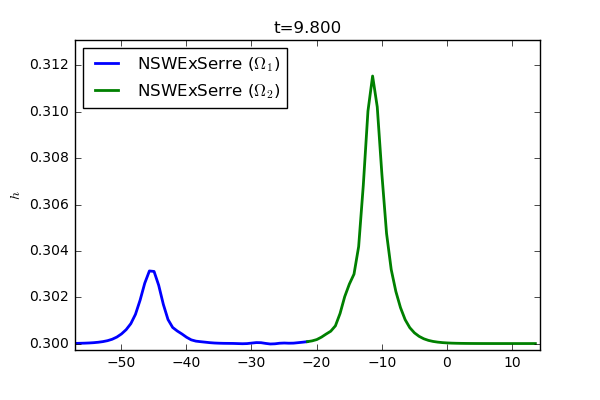
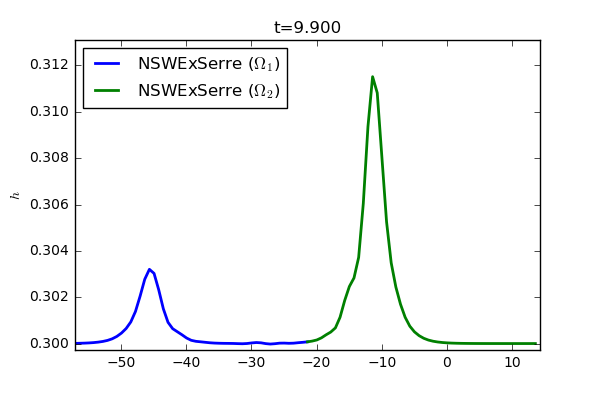
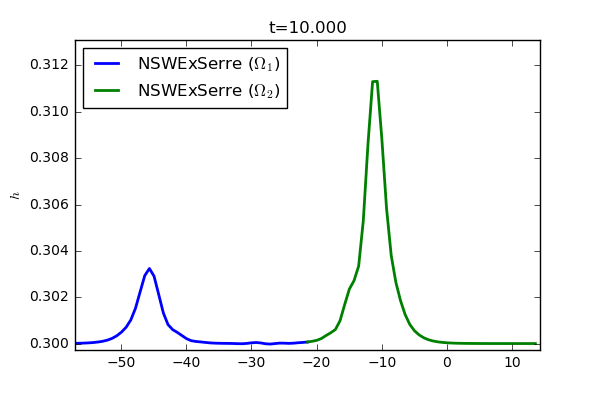
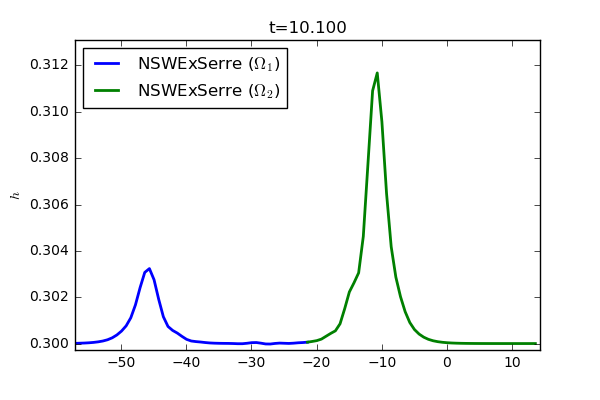

In [204]:
lb = ["NSWExSerre ($\Omega_1$)", "NSWExSerre ($\Omega_2$)"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1DRP,x2DRP]),
                                     np.array([hall1DRP,hall2DRP]),
                                     tall1DR,xmin,xmax,0.99*h0,1.01*hmax,lb,ylabel=r'$h$')

## Some conclusions

Setting the interface of the subdomains in the middle point of the monodomain, we can see clearly the difference between the NSWE and the Serre models, by comparing the behavior of the two waves that travel in opposite senses: the wave in the subdomain with Serre as its shape preserved, because the dispersive part of the Serre equation is able to "correct" the shock formation caused by the NSWE model.
